In [1]:
import time
import hydroeval as he
import json
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import xarray as xr
import sys
from datetime import date
from datetime import datetime, timedelta
from sklearn.linear_model import LinearRegression
from scipy.stats import sem
from sklearn.metrics import mean_squared_error
import math
from scipy import stats
import statistics
import os

import geopandas as gpd
from shapely.geometry import Point
import matplotlib.colors as mcolors

#### **STATION STATS (Maximums)**

In [3]:
# File paths
input_file = 'DataFolder/annual_max_matched.csv'
output_file = 'Stat_folder/3_spatial_stat.csv'

# Durations and corresponding column name suffixes
durations = {'30m': 0.5, '1h': 1, '2h': 2, '3h': 3, '6h': 6, '12h': 12, '24h': 24, '48h': 48, '72h': 72}

# Read CSV data
df = pd.read_csv(input_file)

# Output list
output_rows = []

# Group by unique station ID
for station_id, group in df.groupby('ID'):
    row = {'ID': station_id}
    row['Lat'] = group['Lat'].iloc[0]
    row['Lon'] = group['Lon'].iloc[0]

    for suffix, duration in durations.items():
        obs_col = f'obs{suffix}'
        pre_col = f'pre{suffix}'

        if obs_col in group.columns and pre_col in group.columns:
            obs = group[obs_col].values
            pre = group[pre_col].values

            # Drop NaNs
            mask = ~np.isnan(obs) & ~np.isnan(pre)
            obs = obs[mask]
            pre = pre[mask]

            if len(obs) > 0:
                # === Existing statistics ===
                r = np.round(np.corrcoef(obs, pre)[0, 1], 3)
                rb = np.round((np.sum(pre - obs) / np.sum(obs)) * 100, 3)
                rmse = np.round(np.sqrt(np.mean((pre - obs) ** 2)), 5)
                nrmse = np.round(rmse / duration, 5)

                # === New statistics ===
                # Mean Bias Ratio (clipped [0,1])
                mbr = np.mean(pre) / np.mean(obs)
                mbr = float(np.clip(mbr, 0, 1))
                mbr = np.round(mbr, 5)

                # NSE
                nse = he.evaluator(he.nse, pre, obs)[0]
                nse = np.round(float(nse), 5)

                # KGE
                kge, r_cor, alpha, beta = he.evaluator(he.kge, pre, obs)
                kge = np.round(float(kge[0]), 5)

            else:
                r, rb, rmse, nrmse = [np.nan] * 4
                mbr, nse, kge = [np.nan] * 3

            # Add to row
            row[f'r{suffix}'] = r
            row[f'rb{suffix}'] = rb
            row[f'rmse{suffix}'] = rmse
            row[f'nrmse{suffix}'] = nrmse
            row[f'mbr{suffix}'] = mbr
            row[f'nse{suffix}'] = nse
            row[f'kge{suffix}'] = kge

    output_rows.append(row)

# Save to output CSV
df_out = pd.DataFrame(output_rows)
df_out.to_csv(output_file, index=False)

print(f"Statistics saved to {output_file}")

Statistics saved to Stat_folder/3_spatial_stat.csv


#### **STATION STATS (PMP)**

In [5]:
# File paths
input_file = './DataFolder/pmp_data.csv'
output_file = 'Stat_folder/4_spatial_stat_pmp.csv'

# Load the CSV file
df = pd.read_csv(input_file)

# Define durations
durations = ['30m', '1h', '2h', '3h', '6h', '12h', '24h', '48h', '72h']

# Function to calculate PRB
def calculate_prb(row, duration):
    obs_col = f'obs{duration}'
    pre_col = f'pre{duration}'
    obs_val = row[obs_col]
    pre_val = row[pre_col]

    if obs_val == 0:
        return None  # Avoid division by zero
    return ((pre_val - obs_val) / obs_val) * 100 

# Calculate PRB columns
for duration in durations:
    df[f'PRB_{duration}'] = df.apply(calculate_prb, args=(duration,), axis=1)

# Group by unique ID and calculate mean PRB values
prb_summary = df.groupby('ID').agg({
    'Lat': 'first',
    'Lon': 'first',
    **{f'PRB_{duration}': 'mean' for duration in durations}
}).reset_index()

# Rename columns to match output format
prb_summary.rename(columns={f'PRB_{d}': f'PRB{d}' for d in durations}, inplace=True)

# Save the result
prb_summary.to_csv(output_file, index=False)

print("Completed Processing")


Completed Processing


### **SPATIAL MAPPING (Maximums)**

### **(1) correlation (r)**

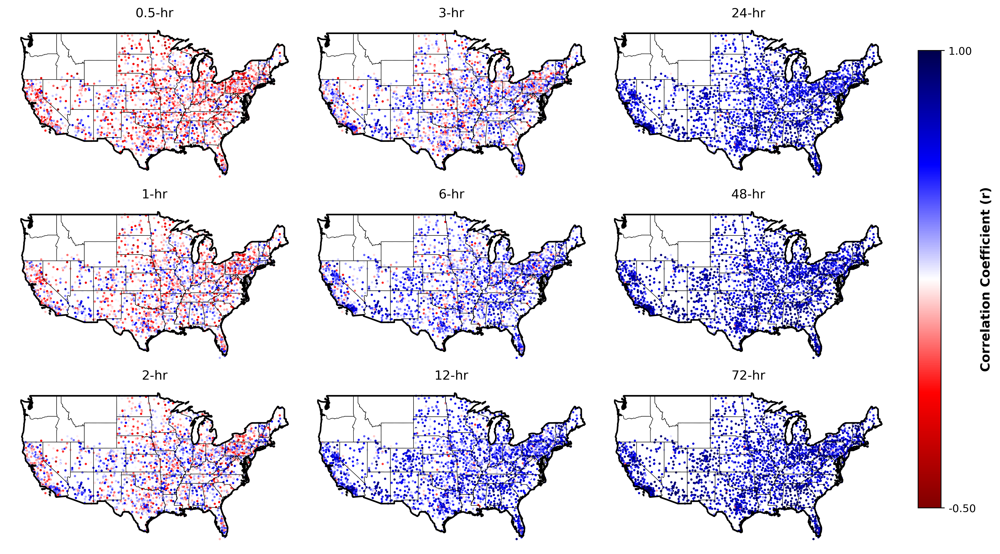

In [9]:
# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["r30m", "r1h", "r2h", "r3h", "r6h", "r12h", "r24h", "r48h", "r72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and set vmax to 1
vmin = round(df[columns].min().min(), 2)
vmax = 1  # Since r values typically range between -1 and 1, we set vmax to 1

# Define the colormap and norm
cmap = plt.get_cmap('seismic_r') # Blues, Reds, coolwarm, seismic, seismic_r
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Correlation Coefficient (r)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin:.2f}', f'{vmax:.2f}'])  # Format the tick labels to two decimal places

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_1R")
plt.show()


### **(2) rmse**

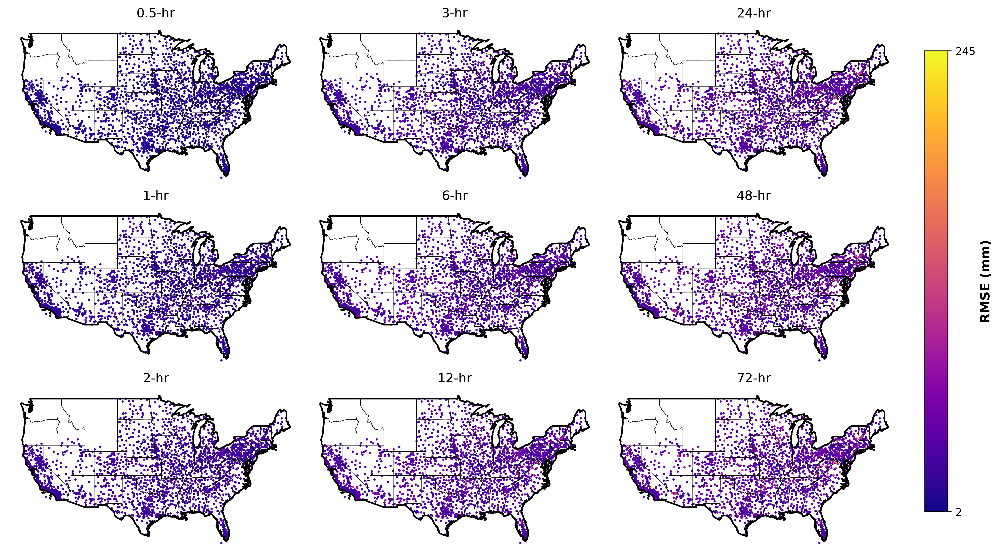

In [14]:

# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["rmse30m", "rmse1h", "rmse2h", "rmse3h", "rmse6h", "rmse12h", "rmse24h", "rmse48h", "rmse72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormap and norm
cmap = plt.get_cmap('plasma')  # coolwarm, seismic, seismic_r, plasma
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('RMSE (mm)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin}', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_2rmse")
plt.show()

### **(3) nrmse**

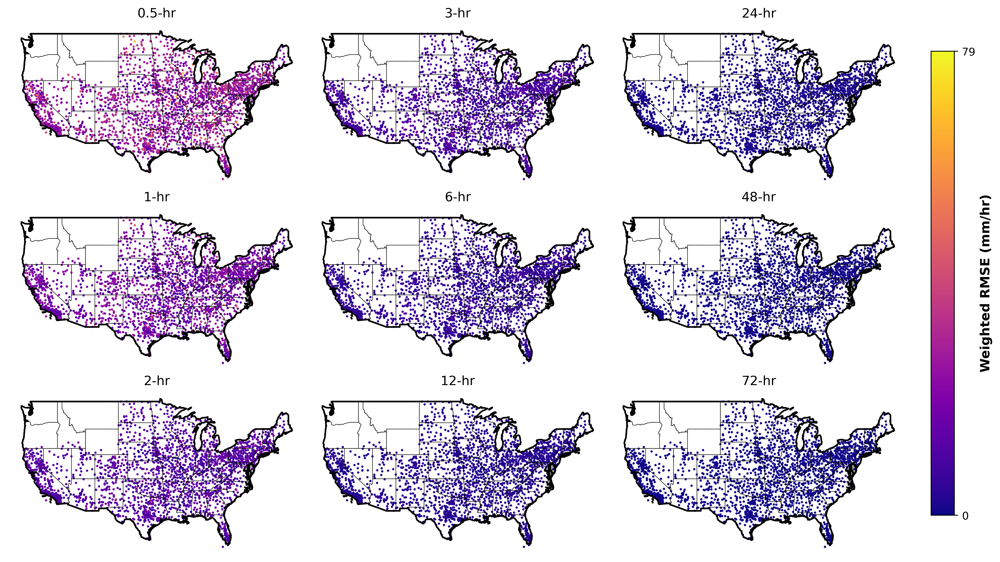

In [9]:

# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["nrmse30m", "nrmse1h", "nrmse2h", "nrmse3h", "nrmse6h", "nrmse12h", "nrmse24h", "nrmse48h", "nrmse72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormap and norm
cmap = plt.get_cmap('plasma')  # coolwarm, seismic, seismic_r, plasma
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Weighted RMSE (mm/hr)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin}', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_3nrmse")
plt.show()

### **(4) relative bias (rb)**

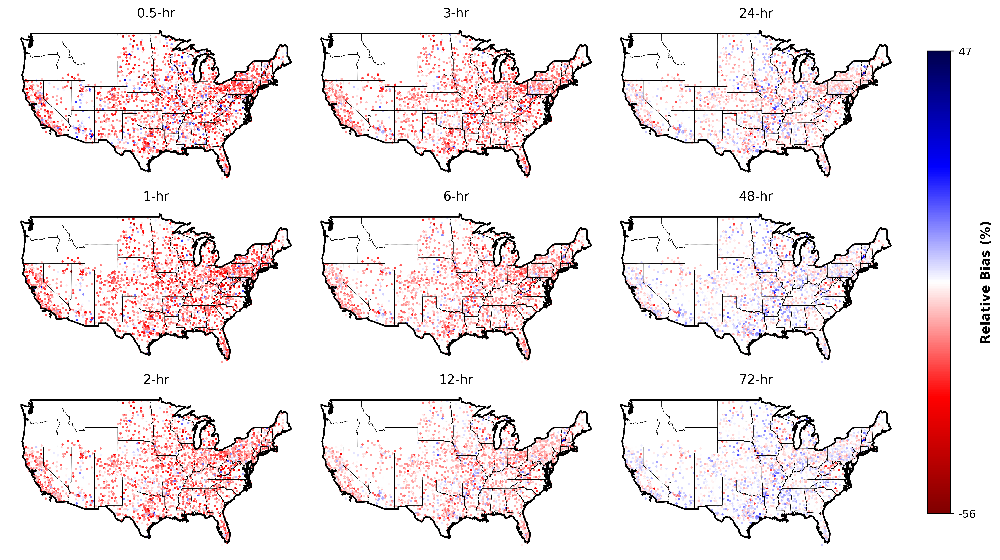

In [24]:
# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["rb30m", "rb1h", "rb2h", "rb3h", "rb6h", "rb12h", "rb24h", "rb48h", "rb72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormap and norm
cmap = plt.get_cmap('seismic_r')  # coolwarm, seismic, seismic_r, plasma
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Relative Bias (%)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin}', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_4rb")
plt.show()

### **(5) MBR**

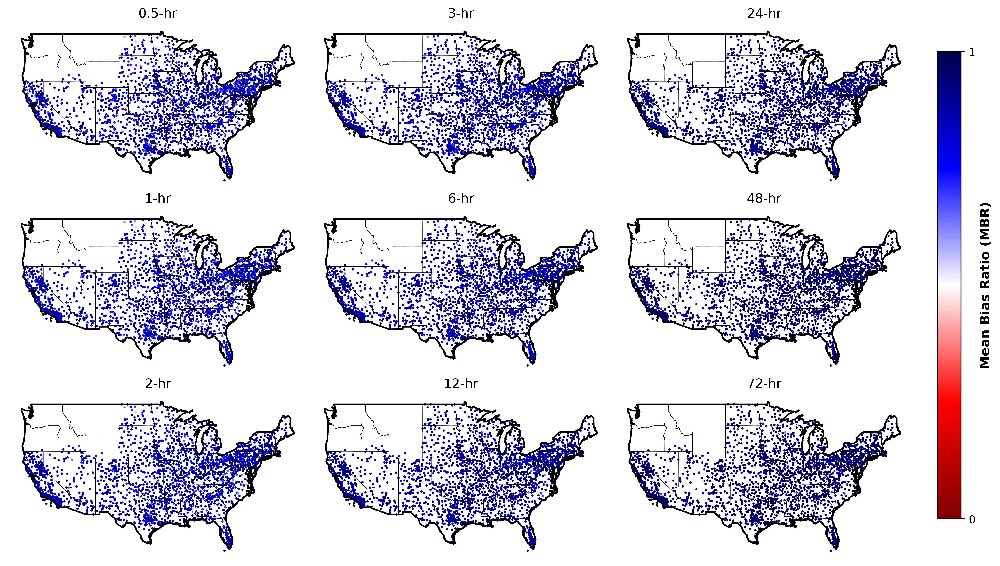

In [8]:
# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["mbr30m", "mbr1h", "mbr2h", "mbr3h", "mbr6h", "mbr12h", "mbr24h", "mbr48h", "mbr72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormap and norm
cmap = plt.get_cmap('seismic_r')  # coolwarm, seismic, seismic_r, plasma
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Mean Bias Ratio (MBR)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin}', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_5mbr")
plt.show()

### **(6) NSE**

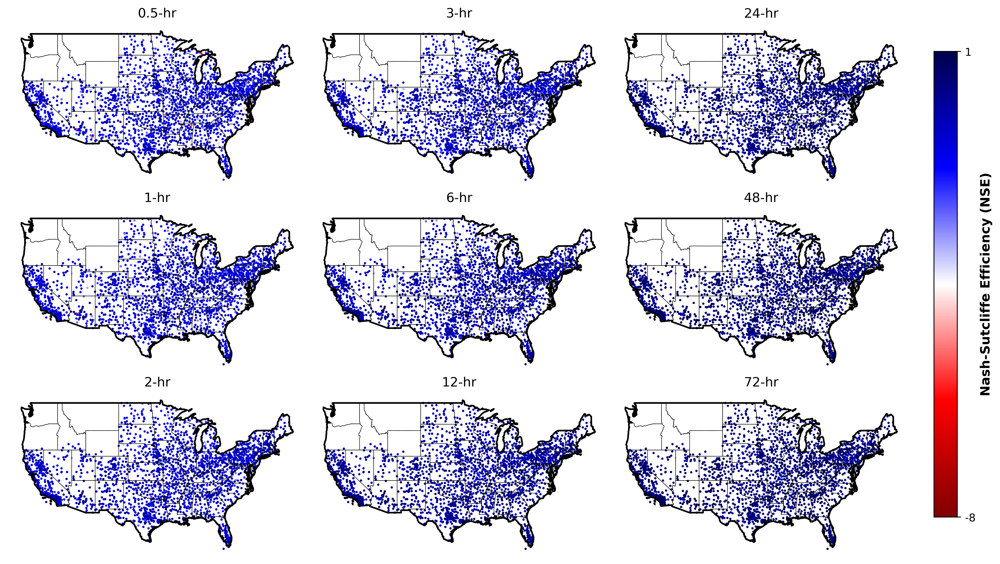

In [6]:
# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["nse30m", "nse1h", "nse2h", "nse3h", "nse6h", "nse12h", "nse24h", "nse48h", "nse72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormap and norm
cmap = plt.get_cmap('seismic_r')  # coolwarm, seismic, seismic_r, plasma
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Nash-Sutcliffe Efficiency (NSE)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin}', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_6nse")
plt.show()

### **(7) KGE**

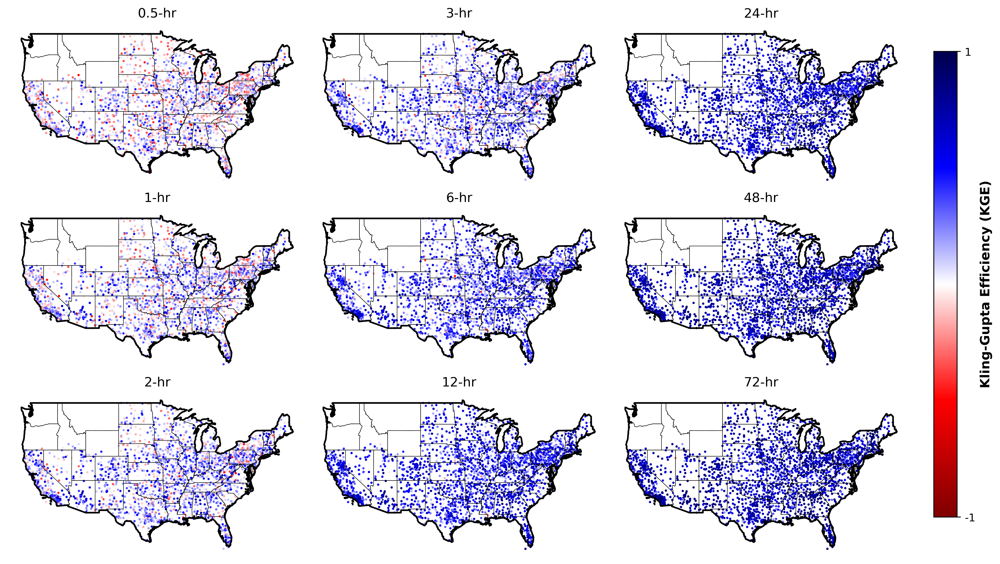

In [7]:
# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["kge30m", "kge1h", "kge2h", "kge3h", "kge6h", "kge12h", "kge24h", "kge48h", "kge72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormap and norm
cmap = plt.get_cmap('seismic_r')  # coolwarm, seismic, seismic_r, plasma
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')
    geo_df.plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap, norm=norm)
    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Kling-Gupta Efficiency (KGE)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, vmax])  # Show only the min and max values
cbar.ax.set_yticklabels([f'{vmin}', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_7kge")
plt.show()

### **SPATIAL MAPPING (PMP)**

### **Percentage relative bias (PRB)**

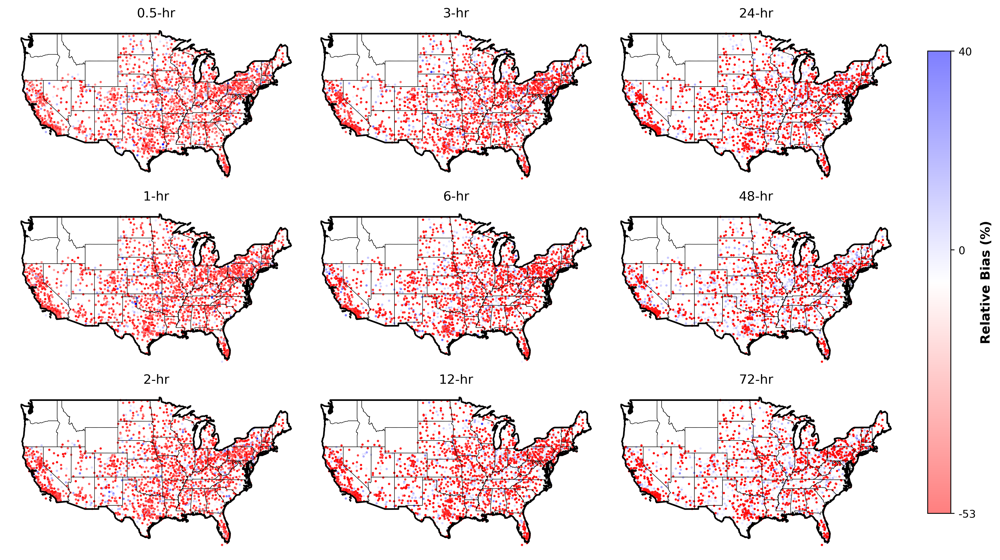

In [23]:

# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/4_spatial_stat_pmp.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["PRB30m", "PRB1h", "PRB2h", "PRB3h", "PRB6h", "PRB12h", "PRB24h", "PRB48h", "PRB72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormaps for positive and negative values with deep blue and deep red
cmap_pos = mcolors.LinearSegmentedColormap.from_list('deep_blue', ['#ffffff', '#0000ff'], N=256)
cmap_neg = mcolors.LinearSegmentedColormap.from_list('deep_red', ['#ffffff', '#ff0000'], N=256)
norm_pos = mcolors.Normalize(vmin=0, vmax=vmax)
norm_neg = mcolors.Normalize(vmin=vmin, vmax=0)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')

    # Plot points based on whether their values are above or below zero
    geo_df[geo_df[col] >= 0].plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap_pos, norm=norm_pos)
    geo_df[geo_df[col] < 0].plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap_neg, norm=norm_neg)

    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]

# Combine the colormaps for the colorbar
cmap_combined = mcolors.LinearSegmentedColormap.from_list('Combined', [cmap_neg(0.5), 'white', cmap_pos(0.5)], N=256)
norm_combined = mcolors.Normalize(vmin=vmin, vmax=vmax)
sm = plt.cm.ScalarMappable(cmap=cmap_combined, norm=norm_combined)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Relative Bias (%)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, 0, vmax])  # Show min, 0, and max values
cbar.ax.set_yticklabels([f'{vmin}', '0', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

plt.savefig("Plots/map_pmp_prb")
plt.show()


### **Study Area**

In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show
from rasterio.warp import calculate_default_transform, reproject, Resampling
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LatitudeFormatter, LongitudeFormatter
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib as mpl

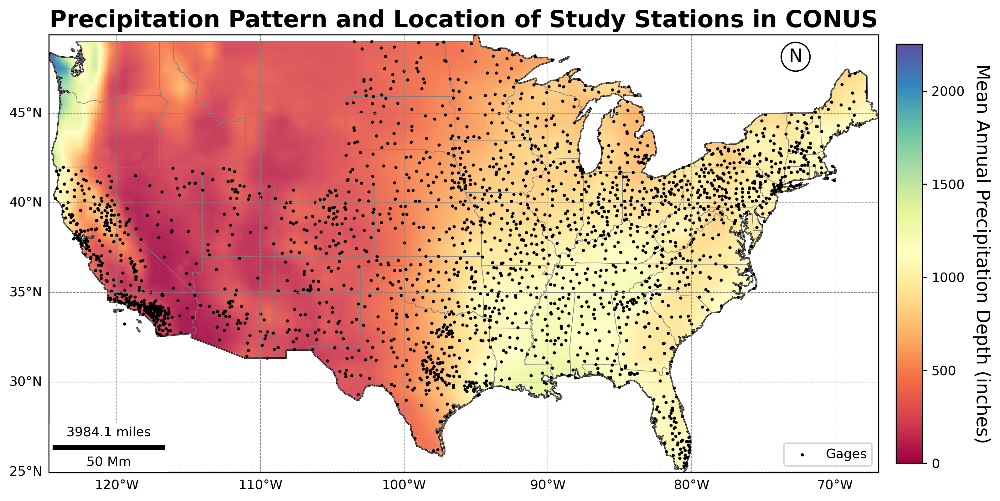

In [89]:

# Define file paths
conus_extent_path = "./GISfolder/conusshp/conus.shp"
statebounds_path = "./GISfolder/conusshp/conusWstates.shp"
gages_path = "./GISfolder/stn.csv"
precip_path = "./GISfolder/precip/Acummulated_Inch_Month.tif"
reprojected_precip_path = 'precip_reprojected.tif'

# Load shapefiles and set CRS to EPSG:4326
conus_extent = gpd.read_file(conus_extent_path).to_crs(epsg=4326)
statebounds = gpd.read_file(statebounds_path).to_crs(epsg=4326)

# Load CSV file and create GeoDataFrame for gages
gages_df = pd.read_csv(gages_path)
gages_gdf = gpd.GeoDataFrame(gages_df, geometry=gpd.points_from_xy(gages_df['Lon'], gages_df['Lat']), crs='EPSG:4326')

# Load raster and reproject to EPSG:4326 if needed
with rasterio.open(precip_path) as src:
    # Check if raster is already in EPSG:4326
    if src.crs.to_string() != 'EPSG:4326':
        transform, width, height = calculate_default_transform(
            src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)
        kwargs = src.meta.copy()
        kwargs.update({
            'crs': 'EPSG:4326',
            'transform': transform,
            'width': width,
            'height': height
        })
        
        with rasterio.open(reprojected_precip_path, 'w', **kwargs) as dst:
            for i in range(1, src.count + 1):
                reproject(
                    source=rasterio.band(src, i),
                    destination=rasterio.band(dst, i),
                    src_transform=src.transform,
                    src_crs=src.crs,
                    dst_transform=transform,
                    dst_crs='EPSG:4326',
                    resampling=Resampling.nearest)
        precip_path_to_use = reprojected_precip_path
    else:
        precip_path_to_use = precip_path

# Plotting
fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=300, subplot_kw={'projection': ccrs.PlateCarree()})

# Set the map extent to the extent of conus_extent
minx, miny, maxx, maxy = conus_extent.total_bounds
ax.set_extent([minx, maxx, miny, maxy], crs=ccrs.PlateCarree())

# Plot raster and create a colormap
with rasterio.open(precip_path_to_use) as precip:
    # Plot the raster
    im = show(precip, ax=ax, transform=ccrs.PlateCarree(), cmap='Spectral', alpha=0.9)
    
    # Create a ScalarMappable for the color bar with range 0 to max precipitation
    norm = mpl.colors.Normalize(vmin=0, vmax=precip.read(1).max())
    sm = mpl.cm.ScalarMappable(cmap='Spectral', norm=norm) # Blues, Spectral, YlGnBu, RdYlBu
    sm.set_array([])

# Plot shapefiles
conus_extent.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1, label="CONUS Extent")
statebounds.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=0.4, label="State Boundaries")

# Plot gages
gages_gdf.plot(ax=ax, color='black', markersize=2, label="Gages")

# Add map elements
# Add legend
ax.legend(loc='lower right')

# Add gridlines, labels, and ticks
gridlines = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', linestyle='--')
gridlines.top_labels = False  # Disable labels at the top
gridlines.right_labels = False  # Disable labels on the right
ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter())

# Add north arrow
ax.text(0.90, 0.95, 'N', transform=ax.transAxes, fontsize=14, verticalalignment='center', horizontalalignment='center',
        bbox=dict(facecolor='white', edgecolor='black', boxstyle='circle'))

# Calculate the scale bar length based on the map's extent
# Convert degrees to kilometers; 1 degree latitude ≈ 111 km
map_width_deg = maxx - minx  # in degrees
scalebar_length_km = map_width_deg * 111  # convert to kilometers

# Convert the scale bar length to miles
scalebar_length_miles = scalebar_length_km / 1.60934  # convert kilometers to miles

# Add scale bar in kilometers but label it as miles
scalebar = ScaleBar(scalebar_length_km, units='km', location='lower left', length_fraction=0.2)
ax.add_artist(scalebar)

# Adjust the scale bar label to show miles
scalebar_label = f"{scalebar_length_miles:.1f} miles"
scalebar.label = scalebar_label

# Add color bar for the precipitation, aligned to the height of the map and close to it
cbar = plt.colorbar(sm, ax=ax, orientation='vertical', fraction=0.03, pad=0.02, aspect=16)
cbar.set_label('Mean Annual Precipitation Depth (inches)', rotation=270, labelpad=20, fontweight='light', fontsize=14)

# Set title
ax.set_title('Precipitation Pattern and Location of Study Stations in CONUS', fontweight='bold', fontsize=18)

# plt.savefig("Plots/studyarea")
plt.show()


## Extra Codes

In [ ]:

# Step 1: Load the CONUS shapefiles
conus_shapefile = "./GISfolder/conusshp/conus.shp"
conusWstates_shapefile = "./GISfolder/conusshp/conusWstates.shp"

conus = gpd.read_file(conus_shapefile)
conusWstates = gpd.read_file(conusWstates_shapefile)

# Reproject the shapefiles to Web Mercator (EPSG:3857)
conus = conus.to_crs(epsg=3857)
conusWstates = conusWstates.to_crs(epsg=3857)

# Step 2: Load the CSV file and create a GeoDataFrame
csv_file = "./Stat_folder/3_spatial_stat.csv"
df = pd.read_csv(csv_file)

# Convert Lat and Lon to Points
geometry = [Point(xy) for xy in zip(df['Lon'], df['Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Reproject the GeoDataFrame to Web Mercator (EPSG:3857)
geo_df = geo_df.to_crs(epsg=3857)

# Step 3: Create 9 subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 15), dpi=400)

# Columns to plot
titles = ['0.5-hr', '1-hr', '2-hr', '3-hr', '6-hr', '12-hr', '24-hr', '48-hr', '72-hr']
columns = ["rb30m", "rb1h", "rb2h", "rb3h", "rb6h", "rb12h", "rb24h", "rb48h", "rb72h"]
positions = [(0, 0), (1, 0), (2, 0), (0, 1), (1, 1), (2, 1), (0, 2), (1, 2), (2, 2)]

# Find the overall min and max for the color scaling and round to nearest whole number
vmin = round(df[columns].min().min())
vmax = round(df[columns].max().max())

# Define the colormaps for positive and negative values with deep blue and deep red
cmap_pos = mcolors.LinearSegmentedColormap.from_list('deep_blue', ['#ffffff', '#0000ff'], N=256)
cmap_neg = mcolors.LinearSegmentedColormap.from_list('deep_red', ['#ffffff', '#ff0000'], N=256)
norm_pos = mcolors.Normalize(vmin=0, vmax=vmax)
norm_neg = mcolors.Normalize(vmin=vmin, vmax=0)

# Step 4: Plot each column using a single colorbar on the right
for col, pos, title in zip(columns, positions, titles):
    ax = axs[pos[0], pos[1]]
    ax.set_frame_on(False)  # Turn off the bounding box outline
    conus.boundary.plot(ax=ax, linewidth=1.5, color='black')
    conusWstates.boundary.plot(ax=ax, linewidth=0.4, color='black')

    # Plot points based on whether their values are above or below zero
    geo_df[geo_df[col] >= 0].plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap_pos, norm=norm_pos)
    geo_df[geo_df[col] < 0].plot(column=col, ax=ax, marker='.', markersize=5, cmap=cmap_neg, norm=norm_neg)

    ax.set_title(title)
    ax.axis('off')  # Turn off axis ticks and labels

# Create the colorbar with extremes shown
cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])  # [left, bottom, width, height]

# Combine the colormaps for the colorbar
cmap_combined = mcolors.LinearSegmentedColormap.from_list('Combined', [cmap_neg(0.5), 'white', cmap_pos(0.5)], N=256)
norm_combined = mcolors.Normalize(vmin=vmin, vmax=vmax)
sm = plt.cm.ScalarMappable(cmap=cmap_combined, norm=norm_combined)
sm._A = []  # Dummy data for the colorbar
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Relative Bias (%)', fontsize=12, fontweight='bold')  # Adjustable size and boldness
cbar.set_ticks([vmin, 0, vmax])  # Show min, 0, and max values
cbar.ax.set_yticklabels([f'{vmin}', '0', f'{vmax}'])  # Format the tick labels

# plt.suptitle('Percentage Relative Bias Across CONUS', fontweight='bold', fontsize=18)

# Adjust layout to reduce vertical spacing
plt.subplots_adjust(hspace=-0.65, wspace=0.01)

# plt.savefig("Plots/map_rb")
plt.show()